## BREAST CANCER CLASSIFICATION

## IMPORTING THE PACKAGES

In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing
from numba import njit

In [2]:
#VISUALIZATION
from matplotlib.colors import ListedColormap
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
sns.set()
import cv2 as cv


In [3]:
from sklearn import svm
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.decomposition import PCA



In [4]:
from glob import glob
from skimage import io
from os import listdir
import pickle

import time
import copy
from tqdm.notebook import tqdm
tqdm().pandas();5

print('import complete')

import complete


C:\Users\Vaishnavi\New folder\lib\site-packages\tqdm\std.py:658: FutureWarning: The Panel class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  from pandas import Panel


## Exploring the datastructure on breast cancer histopathology images

In [5]:
files = listdir(r"C:\Users\Vaishnavi\Desktop\ml project\breast-histopathology-images\IDC_regular_ps50_idx5")
print(len(files))

279


We have a total number of about 280 sub-folders, let's take a peak into the folder and try and understand what those sub-folders are.

In [6]:
files[0:10]

['10253',
 '10254',
 '10255',
 '10256',
 '10257',
 '10258',
 '10259',
 '10260',
 '10261',
 '10262']


Each subfolder is the ID of the corresponding patient

In [7]:
patient_file = listdir(r"C:\Users\Vaishnavi\Desktop\ml project\breast-histopathology-images\IDC_regular_ps50_idx5\13689")
print(len(patient_file))

2


In [8]:
patient_file

['0', '1']

Each file has 2 sub-folders, labeled 1 and 0 
Folder 0: Non-Invasive Ductal Carcinoma (IDC) 
Folder 1 : Invasive Ductal Carcinoma (IDC) 

In [9]:
class_0 = listdir(r"C:\Users\Vaishnavi\Desktop\ml project\breast-histopathology-images\IDC_regular_ps50_idx5\13689/0")

class_0

['13689_idx5_x1001_y1101_class0.png',
 '13689_idx5_x1001_y1151_class0.png',
 '13689_idx5_x1001_y1201_class0.png',
 '13689_idx5_x1001_y1301_class0.png',
 '13689_idx5_x1001_y151_class0.png',
 '13689_idx5_x1001_y201_class0.png',
 '13689_idx5_x1001_y251_class0.png',
 '13689_idx5_x1001_y451_class0.png',
 '13689_idx5_x1001_y651_class0.png',
 '13689_idx5_x1001_y701_class0.png',
 '13689_idx5_x1001_y751_class0.png',
 '13689_idx5_x1001_y801_class0.png',
 '13689_idx5_x1001_y851_class0.png',
 '13689_idx5_x101_y1251_class0.png',
 '13689_idx5_x101_y1301_class0.png',
 '13689_idx5_x101_y1351_class0.png',
 '13689_idx5_x101_y1401_class0.png',
 '13689_idx5_x101_y1451_class0.png',
 '13689_idx5_x101_y1501_class0.png',
 '13689_idx5_x101_y1551_class0.png',
 '13689_idx5_x101_y1601_class0.png',
 '13689_idx5_x101_y1651_class0.png',
 '13689_idx5_x1051_y1101_class0.png',
 '13689_idx5_x1051_y1151_class0.png',
 '13689_idx5_x1051_y1201_class0.png',
 '13689_idx5_x1051_y1251_class0.png',
 '13689_idx5_x1051_y1301_class

In [10]:
class_1 = listdir(r"C:\Users\Vaishnavi\Desktop\ml project\breast-histopathology-images\IDC_regular_ps50_idx5\13689/1")


## files containing the pictures of each patient, as follows:

## Patient_id/xcoordinate_of_patch/ycoordinate_of_patch/class_of_cancer

we have total number of 280 patients. 

This sample size is relatively small therefore not to overfit our model. We will implement our model in such a way that it maximizes generalization.

Each patient has a batch of patches that were extracted, therefore the total number of patches is likely much greater than 280.



In [11]:
base_path =r'C:/Users/Vaishnavi/Desktop/ml project/breast-histopathology-images/IDC_regular_ps50_idx5/'
patient_ids = listdir(base_path)

Here each patch will act as an input.

it will extracts the patches for class 1 and 0 and also total number of patches for each of the classes

In [12]:
class_0_total = 0
class_1_total = 0
from pprint import pprint
for patient_id in patient_ids:
    class_0_files = listdir(base_path + patient_id + '/0')
    class_1_files = listdir(base_path + patient_id + '/1')

    class_0_total += len(class_0_files)
    class_1_total += len(class_1_files) 

total_images = class_0_total + class_1_total
    
print(f'Number of patches in Class 0: {class_0_total}')
print(f'Number of patches in Class 1: {class_1_total}')
print(f'Total number of patches: {total_images}')

Number of patches in Class 0: 198738
Number of patches in Class 1: 78786
Total number of patches: 277524


## Storing the image_path, patient_id, target and x & y coordinates

We have about 278,000 images. To feed the algorithm with image patches we will store the path of each image and create a dataframe containing all the paths. 

In this way we can load batches of images one by one without storing the individual pixel values of all images. 


In [13]:
from os import listdir
import pandas as pd
columns = ["patient_id",'x','y',"target","path"]
data_rows = []
i = 0
iss = 0
isss = 0

base_path =r'C:/Users/Vaishnavi/Desktop/ml project/breast-histopathology-images/IDC_regular_ps50_idx5/'

patient_ids = listdir(base_path)

# note that we loop through the classes after looping through the 
# patient ids so that we avoid splitting our data into [all class 0 then all class 1]
for patient_id in patient_ids:
    for c in [0,1]:
        class_path = base_path + patient_id + '/' + str(c) + '/'
        imgs = listdir(class_path)
        
        # Extracting Image Paths
        img_paths = [class_path + img + '/' for img in imgs]
        
        # Extracting Image Coordinates
        img_coords = [img.split('_',4)[2:4] for img in imgs]
        x_coords = [int(coords[0][1:]) for coords in img_coords]
        y_coords = [int(coords[1][1:]) for coords in img_coords]

        for (path,x,y) in zip(img_paths,x_coords,y_coords):
            values = [patient_id,x,y,c,path]
            data_rows.append({k:v for (k,v) in zip(columns,values)})
columns = ["patient_id",'x','y',"target","path"]
data_rows = []
i = 0
iss = 0
isss = 0

# note that we loop through the classes after looping through the 
# patient ids so that we avoid splitting our data into [all class 0 then all class 1]
for patient_id in patient_ids:
    for c in [0,1]:
        class_path = base_path + patient_id + '/' + str(c) + '/'
        imgs = listdir(class_path)
        
        # Extracting Image Paths
        img_paths = [class_path + img + '/' for img in imgs]
        
        # Extracting Image Coordinates
        img_coords = [img.split('_',4)[2:4] for img in imgs]
        x_coords = [int(coords[0][1:]) for coords in img_coords]
        y_coords = [int(coords[1][1:]) for coords in img_coords]

        for (path,x,y) in zip(img_paths,x_coords,y_coords):
            values = [patient_id,x,y,c,path]
            data_rows.append({k:v for (k,v) in zip(columns,values)})

# We create a new dataframe using the list of dicts that we generated above
data = pd.DataFrame(data_rows)
print(data.shape)
data.head()

(277524, 5)


,patient_id,x,y,target,path
0,10253,1001,1001,0,C:/Users/Vaishnavi/Desktop/ml project/breast-h...
1,10253,1001,1051,0,C:/Users/Vaishnavi/Desktop/ml project/breast-h...
2,10253,1001,1101,0,C:/Users/Vaishnavi/Desktop/ml project/breast-h...
3,10253,1001,1151,0,C:/Users/Vaishnavi/Desktop/ml project/breast-h...
4,10253,1001,1201,0,C:/Users/Vaishnavi/Desktop/ml project/breast-h...


## Exploratory Data Analysis

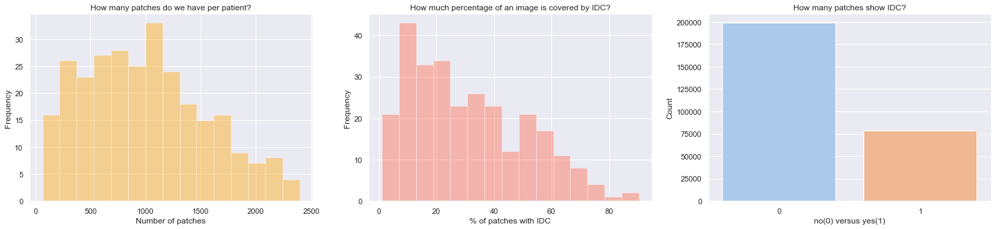

In [14]:
import matplotlib.pyplot as plt
import seaborn as sns
cancer_perc = data.groupby("patient_id").target.value_counts()/ data.groupby("patient_id").target.size()
cancer_perc = cancer_perc.unstack()

fig, ax = plt.subplots(1,3,figsize=(25,5))

# Plotting Frequency of Patches per Patient
sns.distplot(data.groupby("patient_id").size(), ax=ax[0], color="Orange", kde=False, bins=15)
ax[0].set_xlabel("Number of patches")
ax[0].set_ylabel("Frequency")
ax[0].set_title("How many patches do we have per patient?")

# Plotting Percentage of an image that is covered by Invasive Ductile Carcinoma
sns.distplot(cancer_perc.loc[:, 1]*100, ax=ax[1], color="Tomato", kde=False, bins=15)
ax[1].set_title("How much percentage of an image is covered by IDC?")
ax[1].set_ylabel("Frequency")
ax[1].set_xlabel("% of patches with IDC")

# Plotting number of patches that show IDC
sns.countplot(data.target, palette='pastel', ax=ax[2]);
ax[2].set_ylabel("Count")
ax[2].set_xlabel("no(0) versus yes(1)")
ax[2].set_title("How many patches show IDC?");

## Healthy Tissue Patches Vs Cancerous Tissue Patches

In [15]:
import numpy as np
# Return random sample indexes that are cancer positive and cancer negative of size 50
# replace = False means that no duplication is allowed
positive_tissue = np.random.choice(data[data.target==1].index.values, size=100, replace=False)
negative_tissue = np.random.choice(data[data.target==0].index.values, size=100, replace=False)

n_rows = 10
n_cols = 10

## Cancerous Patches

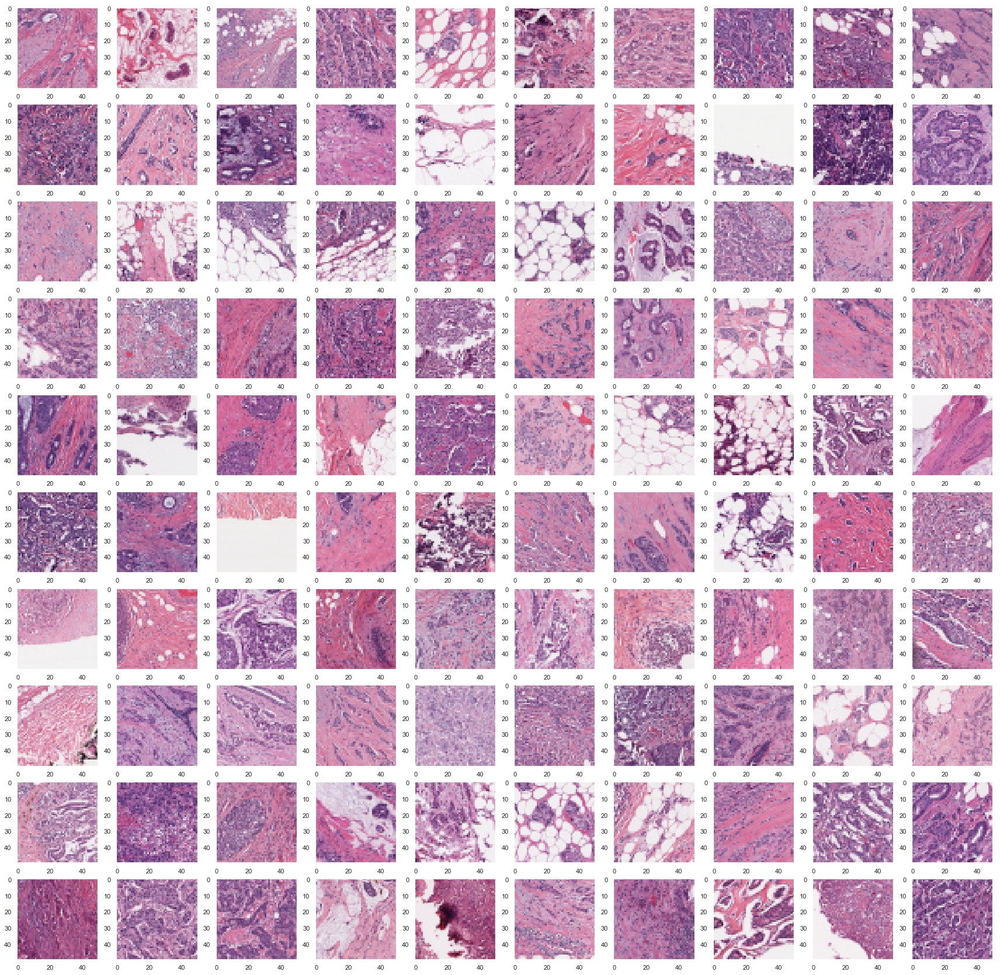

In [16]:
from skimage import io
fig,ax = plt.subplots(n_rows,n_cols,figsize = (30,30))

for row in range(n_rows):
    for col in range(n_cols):
        # below is a counter to cycle through the image indexes
        idx = positive_tissue[col + n_cols*row]
        img = io.imread(data.loc[idx, "path"])
        ax[row,col].imshow(img[:,:,:])
        ax[row,col].grid(False)

## Non-Cancerous Patches

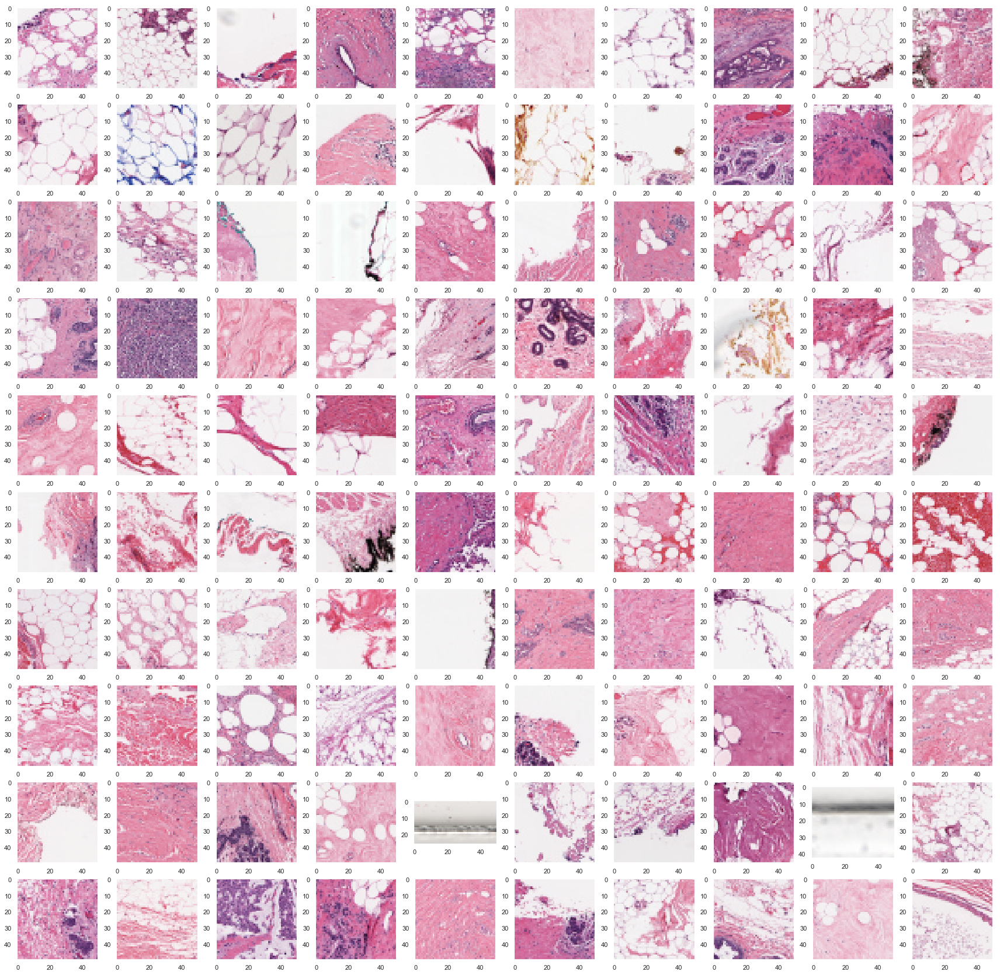

In [17]:
from skimage import io
fig,ax = plt.subplots(n_rows,n_cols,figsize = (30,30))

for row in range(n_rows):
    for col in range(n_cols):
        # below is a counter to cycle through the image indices
        idx = negative_tissue[col + n_cols*row]
        img = io.imread(data.loc[idx, "path"])
        ax[row,col].imshow(img[:,:,:])
        ax[row,col].grid(False)


. here some of them are incomplete patches and some images are also less than 50 x 50 pxs. 

. Patches with cancer look more violet and crowded than healthy ones. 

. Though some of the healthy patches are very violet colored too



In [18]:
def get_patient_df(patient_id):
    return data.loc[data['patient_id']== patient_id,:]

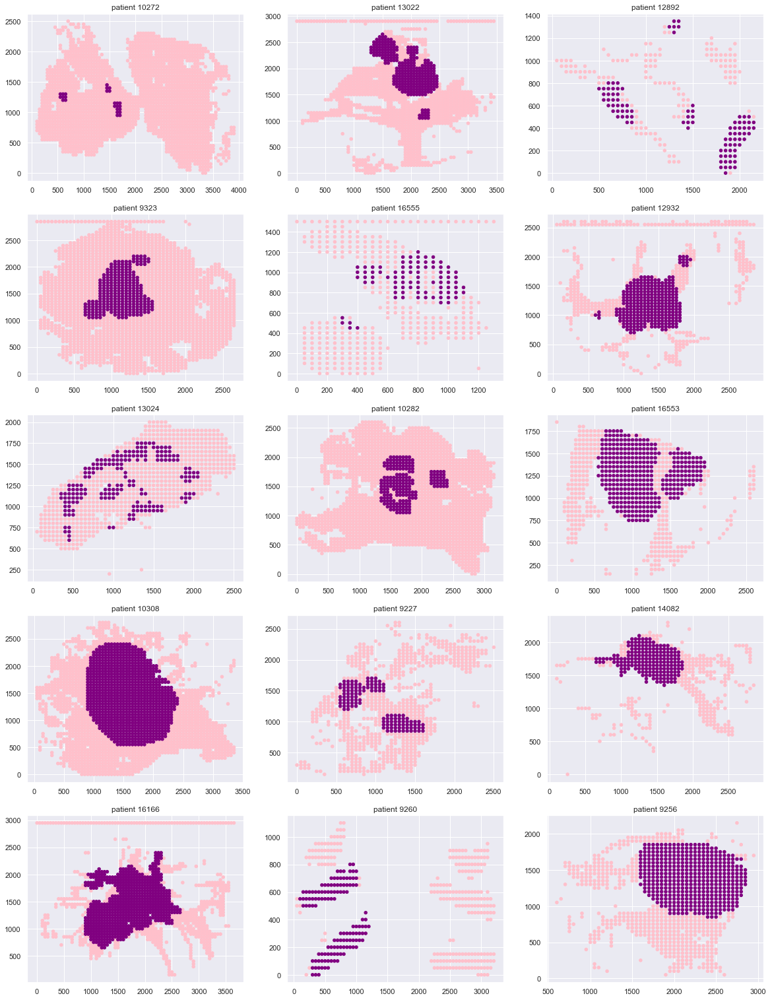

In [19]:
from matplotlib.colors import ListedColormap
n_rows = 5
n_cols = 3
n_imgs = n_rows*n_cols
colors = ['pink', 'purple']

fig, ax = plt.subplots(n_rows,n_cols,figsize=(20, 27))

patient_ids = np.random.choice( data.patient_id.unique(), size=n_imgs, replace=False)

for row in range(n_rows):
    for col in range(n_cols):
        patient_id = patient_ids[col + n_cols*row]
        patient_df = get_patient_df(patient_id)
        
        ax[row,col].scatter(patient_df.x.values, \
                            patient_df.y.values, \
                            c=patient_df.target.values,\
                            cmap=ListedColormap(colors), s=20)
        ax[row,col].set_title("patient " + patient_id)

## Insights

Cancerous Tissue appear in clusters rather than, being dispersed all over the place.

## Repatching the Actual Breast Tissue Image

Here we plot the images themselves on their respective x-y coordinates. 

This will help us visualize how the cancerous tissue looks like from a macro perspective.

In [20]:
def visualise_breast_tissue(patient_id, df = data,pred = False, crop_dimension = [50,50]):
    # Plotting Settings
    plt.xticks([])
    plt.yticks([])
    # Get patient dataframe
    p_df = get_patient_df(patient_id)
    # Get the dimensions of the breast tissue image
    max_coord = np.max((*p_df.x,*p_df.y))
    # Allocate an array to fill image pixels in,use uint8 type as you don't need an int over 255
    grid = 255*np.ones(shape = (max_coord + crop_dimension[0], max_coord + crop_dimension[1], 3)).astype(np.uint8)
    mask = 255*np.ones(shape = (max_coord + crop_dimension[0], max_coord + crop_dimension[1], 3)).astype(np.uint8)
    # Replace array values with values of the image
    for x,y,target,path in zip(p_df['x'],p_df['y'],p_df['target'],p_df['path']):
        try:
            img = io.imread(path)
            # Replace array values with cropped image values
            grid[y:y+crop_dimension[1],x:x+crop_dimension[0]] = img
            # Check if target is cancerous or not
            if target != 0:
                # If the target is cancerous then, replace array values with the color blue
                mask[y:y+crop_dimension[1],x:x+crop_dimension[0]] = [0,0,255]
        except: pass
    # if prediction is not specifies then show the image normally
    if pred == False:
        io.imshow(grid)
        img = grid
    # if prediction is specified then apply a mask to the areas that contain predicted cancerous cells
    else:
        # Specify the desired alpha value
        alpha = 0.78
        # This is step is very important, adding 2 numpy arrays sets the values to float64, which is why convert them back to uint8
        img = (mask * (1.0 - alpha) + grid * alpha).astype('uint8')
        io.imshow(img)
    return img

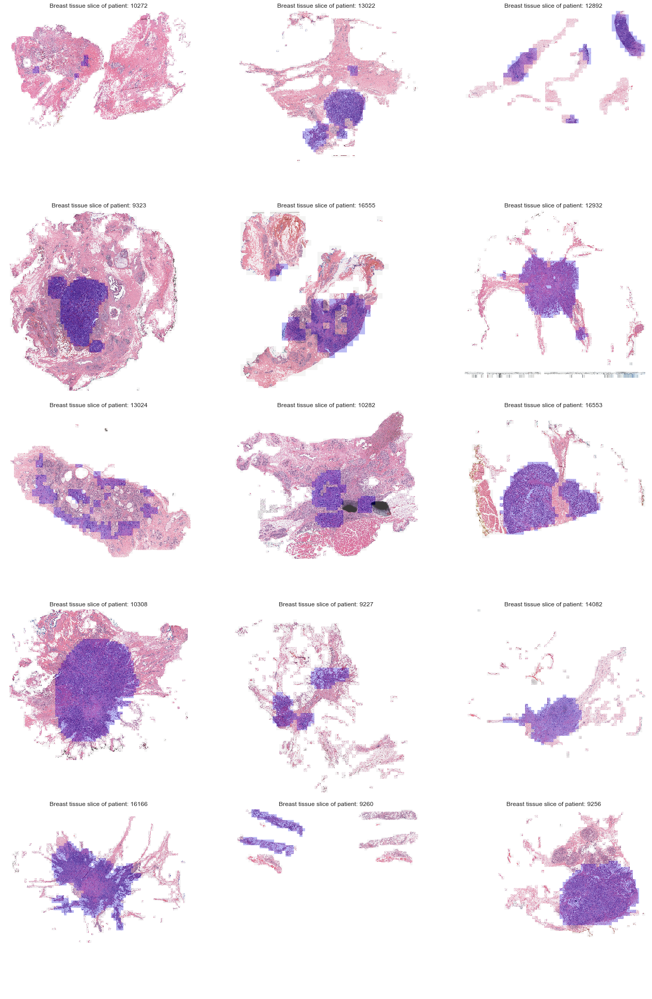

In [21]:
n_rows = 5
n_cols = 3
n_imgs = n_rows*n_cols

fig, ax = plt.subplots(n_rows,n_cols,figsize=(20, 27))

for row in range(n_rows):
    for col in range(n_cols):
        p_id = patient_ids[col + n_cols*row]
        
        img = visualise_breast_tissue(p_id, pred = True)
        ax[row,col].grid(False)
        ax[row,col].set_xticks([])
        ax[row,col].set_yticks([])
        ax[row,col].set_title("Breast tissue slice of patient: " + p_id)        
        ax[row,col].imshow(img)

## Data Augmentation

to avoid overfitting; more data, augmentation, regularization and less complex model architectures. 


Also possible to make a heat map that tells you the most likely region that Invasive Ductal Carcinoma is likely to occur, and to see whether the coordinates can be used as a feature or not.

.Split Data to Training & Testing Data
.Apply Principle Component Analysis (PCA)

## Training & Testing Split

0 -> Tissue does not contain IDC 

1 -> Tissue contains IDC

In [22]:
def get_classes_split(series):
    ratio = np.round(series.value_counts()/series.count()*100,decimals = 1)
    return ratio

In [23]:
(get_classes_split(data['target']))

0    71.6
1    28.4
Name: target, dtype: float64

## Shuffling Our Data

In [24]:
import random
def shuffle_patients(frame):
    groups = [df for _, df in frame.groupby('patient_id')]
    random.shuffle(groups)
    shuffled_df = pd.concat(groups).reset_index(drop=True)
    return shuffled_df

In [25]:
from sklearn.model_selection import train_test_split
for i in range(3):
    data = shuffle_patients(data)
    display(data.head())

,patient_id,x,y,target,path
0,12907,1001,2051,0,C:/Users/Vaishnavi/Desktop/ml project/breast-h...
1,12907,1001,901,0,C:/Users/Vaishnavi/Desktop/ml project/breast-h...
2,12907,1001,951,0,C:/Users/Vaishnavi/Desktop/ml project/breast-h...
3,12907,101,1251,0,C:/Users/Vaishnavi/Desktop/ml project/breast-h...
4,12907,1051,1901,0,C:/Users/Vaishnavi/Desktop/ml project/breast-h...


,patient_id,x,y,target,path
0,12891,101,1401,0,C:/Users/Vaishnavi/Desktop/ml project/breast-h...
1,12891,101,1501,0,C:/Users/Vaishnavi/Desktop/ml project/breast-h...
2,12891,101,1651,0,C:/Users/Vaishnavi/Desktop/ml project/breast-h...
3,12891,1151,1001,0,C:/Users/Vaishnavi/Desktop/ml project/breast-h...
4,12891,1201,1151,0,C:/Users/Vaishnavi/Desktop/ml project/breast-h...


,patient_id,x,y,target,path
0,16552,1001,1001,0,C:/Users/Vaishnavi/Desktop/ml project/breast-h...
1,16552,1001,1051,0,C:/Users/Vaishnavi/Desktop/ml project/breast-h...
2,16552,1001,1101,0,C:/Users/Vaishnavi/Desktop/ml project/breast-h...
3,16552,1001,1151,0,C:/Users/Vaishnavi/Desktop/ml project/breast-h...
4,16552,1001,1201,0,C:/Users/Vaishnavi/Desktop/ml project/breast-h...


In [26]:
(get_classes_split(data['target']))

0    71.6
1    28.4
Name: target, dtype: float64

## Splitting The Data

In [27]:
from sklearn.model_selection import train_test_split

def split_data(data,train_test_percentage = 0.7,percentage_of_dataset = 0.3):
    # get number of datapoints to split from the total dataset
    n_points = round(data.shape[0]*0.2)
    # retrieve the desired initial split of the data based on the specified percentage of the dataset
    data = data[0:n_points]
    # retrieve all the columns except the target columns and store them in X
    X = data.loc[:,data.columns != 'target']
    # retrieve the target column and store them in y 
    y = data.loc[:,['target']]
    # Split the model to training and testing sets for both the features and the targets
    X_train, X_test, y_train, y_test =  train_test_split(X, y, train_size=train_test_percentage, shuffle = False)
    return [X_train, X_test, y_train, y_test]
    



In [28]:
X_train, X_test, y_train, y_test = split_data(data)


In [29]:

print(f'Number of training samples: {X_train.shape[0]} ')
print(f'Number of testing samples: {X_test.shape[0]} ')

Number of training samples: 38853 
Number of testing samples: 16652 


In [30]:
print('training data split:')
display(get_classes_split(y_train.target))
print('testing data split:')
display(get_classes_split(y_test.target))

training data split:


0    70.8
1    29.2
Name: target, dtype: float64

testing data split:


0    79.4
1    20.6
Name: target, dtype: float64

## Principal Component Analysis
1) Reduce the number of features that we have by:
   
      a) Grayscaling
   
      b) Averaging the out the pixel values for each image
   
      C) Downscaling our image

2) Reduce the number of images that we use to train our model

3)The function below, takes a list of paths to the desired images. 
  
  Then reads and reshapes the arrays from (50,50,3) to (2500,3). 
  
  After reshaping it adds the reshaped array to the total array. 
  
  The final array will have a total dimension of (2500*120000,3) = (300000000,3). 
  
  PCA is then applied to this array and the principle components and fitted to this object.


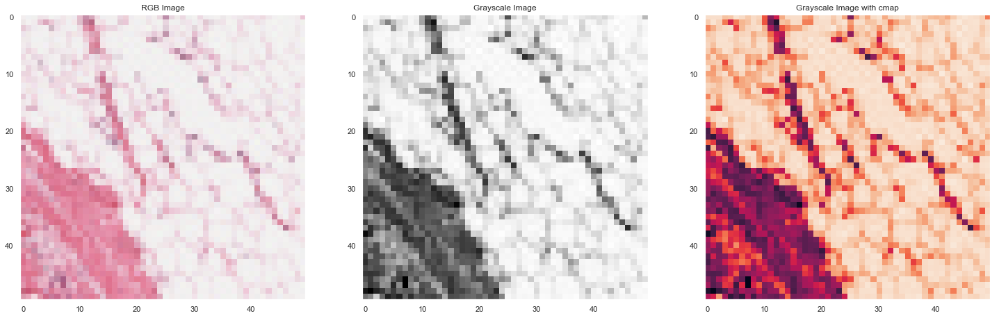

In [31]:
#Path of images
img_path = X_train.path[0]
# reading the images
rgb_img = io.imread(img_path)
gray_img = io.imread(img_path, as_gray = True)
# plot images
fig,ax = plt.subplots(1,3, figsize = (25,50))
ax[0].grid(False)
ax[1].grid(False)
ax[2].grid(False)
# set titles
ax[0].set_title('RGB Image')
ax[1].set_title('Grayscale Image')
ax[2].set_title('Grayscale Image with cmap')
# display images
ax[0].imshow(rgb_img)
ax[1].imshow(gray_img,cmap = 'gray')
ax[2].imshow(gray_img)

## Image Dimension For RGB and Grey Scale Image

In [32]:
print(f'rgb image dimension: {rgb_img.shape}')
print(f'grayscale image dimension: {gray_img.shape}')

rgb image dimension: (50, 50, 3)
grayscale image dimension: (50, 50)


Applying this to our training set X_train by creating a function that reads the images as grayscale, then flattens them and stores them in numpy arrays.

In [33]:
def paths_to_array(paths,n_pixels = 2500):
    imgs_array = np.zeros((paths.shape[0],n_pixels))
    for i,path in tqdm(enumerate(paths),total = imgs_array.shape[0]):
        # Read image
        img = io.imread(path,as_gray = True)
        # Flatten image
        img = img.flatten()
        # Store image in corresponding array row
        imgs_array[i,0:img.shape[0]] = img
    return imgs_array

In [34]:
# Store paths inside variable
paths = X_train.path
# Convert paths to array of images
imgs_array = paths_to_array(paths)
imgs_array.shape

(38853, 2500)

## Average Pixel Values

In [35]:
imgs_array_mean = imgs_array.mean(axis = 1)

In [36]:
X_train['img_mean'] = imgs_array_mean

## Distribution of the Average Image Pixel Value 

In [37]:
import plotly_express as px


avg_fig = px.histogram(X_train, x = "img_mean", color = y_train.target,marginal = "violin")
avg_fig.update_layout(barmode = 'overlay')
avg_fig.update_traces(opacity = 0.75)
avg_fig.update_layout(title_text = 'mean image distribution')
avg_fig.show()

## Getting the average pixel values for each quadrant of the image

In [38]:
def avg_quadrants(flat_img):
    # get the shape of the image array 
    shape = np.sqrt(flat_img.shape[0]).astype(int)
    shape_2 = (shape/2).astype(int)
    # reshape the flat image in order to extract the quadrants
    img = flat_img.reshape(shape,shape)
    # get the mean value for each quadrant
    top_left = img[:shape_2,:shape_2].mean()
    top_right = img[:shape_2,shape_2:].mean()
    bottom_right = img[shape_2:,shape_2:].mean()
    bottom_left = img[shape_2:,:shape_2].mean()
    
    return [top_left,top_right,bottom_left,bottom_right]


 ## Averages of all the images given an array of flattened images.

In [39]:
def get_quadrant_array(imgs_array):
    # initialize array of zeros
    avg_quad_array = np.zeros((imgs_array.shape[0],4))
    # loop through imgs_array and get the averages for each quadrant
    for i in tqdm(range(imgs_array.shape[0])):
        flat_img = imgs_array[i]
        quad_avgs = avg_quadrants(flat_img)
        avg_quad_array[i] = quad_avgs
    return avg_quad_array


In [40]:
avgs_array = get_quadrant_array(imgs_array)

## Visualizing the average quadrant values of an image

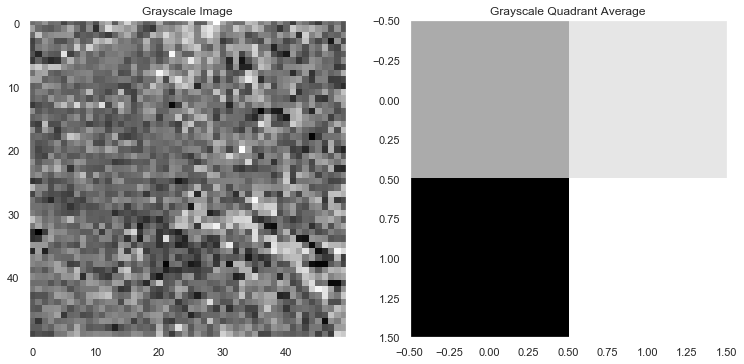

In [41]:
rand_n = np.random.randint(imgs_array.shape[0])
# reading the images
gray_img = imgs_array[rand_n].reshape(50,50)
quad_img = avgs_array[rand_n].reshape(2,2)
# plot images
fig,ax = plt.subplots(1,2, figsize = (12.5,25))
ax[0].grid(False)
ax[1].grid(False)
# set titles
ax[0].set_title('Grayscale Image')
ax[1].set_title('Grayscale Quadrant Average')
# display images
ax[0].imshow(gray_img,cmap = 'gray')
ax[1].imshow(quad_img,cmap = 'gray')

## Adding the new average values to our dataframe

In [42]:
# create a new pandas dataframe using the numpy average quadrant image data
avg_quad_df = pd.DataFrame(avgs_array, columns = ['top_left','top_right','bottom_left','bottom_right'])

In [43]:
avg_quad_df.head()

,top_left,top_right,bottom_left,bottom_right
0,0.869682,0.906100,0.697773,0.904167
1,0.658866,0.816114,0.816362,0.650414
2,0.760888,0.715668,0.894897,0.787884
3,0.882480,0.861937,0.877080,0.777322
4,0.869329,0.799081,0.825143,0.822721


## concatinate our training dataframe with our newly engineered data.

In [44]:
X_train = pd.concat((X_train,avg_quad_df), axis = 1) 
X_train.head()

,patient_id,x,y,path,img_mean,top_left,top_right,bottom_left,bottom_right
0,16552,1001,1001,C:/Users/Vaishnavi/Desktop/ml project/breast-h...,0.844431,0.869682,0.906100,0.697773,0.904167
1,16552,1001,1051,C:/Users/Vaishnavi/Desktop/ml project/breast-h...,0.735439,0.658866,0.816114,0.816362,0.650414
2,16552,1001,1101,C:/Users/Vaishnavi/Desktop/ml project/breast-h...,0.789834,0.760888,0.715668,0.894897,0.787884
3,16552,1001,1151,C:/Users/Vaishnavi/Desktop/ml project/breast-h...,0.849705,0.882480,0.861937,0.877080,0.777322
4,16552,1001,1201,C:/Users/Vaishnavi/Desktop/ml project/breast-h...,0.829069,0.869329,0.799081,0.825143,0.822721


## Visualizing average quadrant data split

In [45]:
# Top Left no cancer 
TL_no_c = X_train.loc[y_train.target == 0,'top_left']
# Top Left with cancer
TL_c = X_train.loc[y_train.target == 1,'top_left']
# Top Right no cancer 
TR_no_c = X_train.loc[y_train.target == 0,'top_right']
# Top Right with cancer
TR_c = X_train.loc[y_train.target == 1,'top_right']
# Bottom Left no cancer 
BL_no_c = X_train.loc[y_train.target == 0,'bottom_left']
# Bottom Left with cancer
BL_c = X_train.loc[y_train.target == 1,'bottom_left']
# Bottom Right no cancer 
BR_no_c = X_train.loc[y_train.target == 0,'bottom_right']
# Bottom Right with cancer
BR_c = X_train.loc[y_train.target == 1,'bottom_right']


In [46]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Initialize figure with subplots
fig = make_subplots(
    rows=2, cols=2, subplot_titles=("Top Left Quadrant", "Top Right Quadrant", "Bottom Left Quadrant", "Bottom Right Quadrant")
)


# Add traces
fig.add_trace(go.Histogram(x=TL_no_c), row=1, col=1)
fig.add_trace(go.Histogram(x=TL_c), row=1, col=1)

fig.add_trace(go.Histogram(x=TR_no_c), row=1, col=2)
fig.add_trace(go.Histogram(x=TR_c), row=1, col=2)

fig.add_trace(go.Histogram(x=BL_no_c), row=2, col=1)
fig.add_trace(go.Histogram(x=BL_c), row=2, col=1)

fig.add_trace(go.Histogram(x=BR_no_c), row=2, col=2)
fig.add_trace(go.Histogram(x=BR_c), row=2, col=2)

# Update xaxis properties
fig.update_xaxes(title_text="Average Top Left Quadrant Values", showgrid=False, row=1, col=1)
fig.update_xaxes(title_text="Average Top Right Quadrant Values", showgrid=False, row=1, col=2)
fig.update_xaxes(title_text="Average Bottom Left Quadrant Values", showgrid=False, row=2, col=1)
fig.update_xaxes(title_text="Average Bottom Right Quadrant Values", showgrid=False, row=2, col=2)

# Update yaxis properties
fig.update_yaxes(title_text="Count", showgrid=False, row=1, col=1)
fig.update_yaxes(title_text="Count", showgrid=False, row=1, col=2)
fig.update_yaxes(title_text="Count", showgrid=False, row=2, col=1)
fig.update_yaxes(title_text="Count", showgrid=False, row=2, col=2)

# Update title and height
fig.update_layout(title_text="Average Quadrant Data Split", height=700)

fig.show()

## Training Model and using support vector machine learning algorithm

In [47]:
from sklearn.svm import SVC
svc = SVC(kernel = 'rbf',gamma = 'auto' )
svc_n = SVC(gamma = 'auto')

In [48]:
X_train.head()

,patient_id,x,y,path,img_mean,top_left,top_right,bottom_left,bottom_right
0,16552,1001,1001,C:/Users/Vaishnavi/Desktop/ml project/breast-h...,0.844431,0.869682,0.906100,0.697773,0.904167
1,16552,1001,1051,C:/Users/Vaishnavi/Desktop/ml project/breast-h...,0.735439,0.658866,0.816114,0.816362,0.650414
2,16552,1001,1101,C:/Users/Vaishnavi/Desktop/ml project/breast-h...,0.789834,0.760888,0.715668,0.894897,0.787884
3,16552,1001,1151,C:/Users/Vaishnavi/Desktop/ml project/breast-h...,0.849705,0.882480,0.861937,0.877080,0.777322
4,16552,1001,1201,C:/Users/Vaishnavi/Desktop/ml project/breast-h...,0.829069,0.869329,0.799081,0.825143,0.822721


In [49]:
X_train = X_train.loc[:,['img_mean','top_left','top_right','bottom_left','bottom_right']]
X_train.head()

,img_mean,top_left,top_right,bottom_left,bottom_right
0,0.844431,0.869682,0.906100,0.697773,0.904167
1,0.735439,0.658866,0.816114,0.816362,0.650414
2,0.789834,0.760888,0.715668,0.894897,0.787884
3,0.849705,0.882480,0.861937,0.877080,0.777322
4,0.829069,0.869329,0.799081,0.825143,0.822721


In [50]:
svc=svc.fit(X_train,y_train)

C:\Users\Vaishnavi\New folder\lib\site-packages\sklearn\utils\validation.py:760: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



In [51]:
svc.score(X_train,y_train)

0.7468149177669678

In [53]:
from sklearn.metrics import confusion_matrix

tn, fp, fn, tp = confusion_matrix(svc.predict(X_train),y_train).ravel()

print(f'training set: true negatives: {tn}')
print(f'training set: true positives: {tp}')
print(f'training set: false negatives: {fn}')
print(f'training set: false positives: {fp}')


training set: true negatives: 25124
training set: true positives: 3892
training set: false negatives: 2403
training set: false positives: 7434


In [66]:
from sklearn.metrics import classification_report
print(classification_report(svc.predict(X_train),y_train))

              precision    recall  f1-score   support

           0       0.91      0.77      0.84     32558
           1       0.34      0.62      0.44      6295

    accuracy                           0.75     38853
   macro avg       0.63      0.69      0.64     38853
weighted avg       0.82      0.75      0.77     38853



Text(0.5,0,'False Positive Rate')

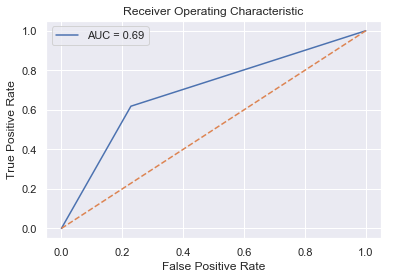

In [63]:
from sklearn.metrics import roc_curve, auc
false_positive_rate, true_positive_rate, thresholds = roc_curve(svc.predict(X_train), y_train, pos_label=1)

# calculate AUC
roc_auc = auc(false_positive_rate, true_positive_rate)

plt.title('Receiver Operating Characteristic')
# plot the false positive rate on the x axis and the true positive rate on the y axis
roc_plot = plt.plot(false_positive_rate,
                    true_positive_rate,
                    label='AUC = {:0.2f}'.format(roc_auc))

plt.legend(loc=0)
plt.plot([0,1], [0,1], ls='--')
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')